# Install and Import Library

In [1]:
pip install opendatasets

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 kB 2.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 34.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 89.3 MB/s eta 0:00:00:00:0100:01
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.11.0.86
    Uninstalling opencv-python-headless-4.11.0.86:
      Successfully uninstalled opencv-python-headless-4.11.0.86
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datasets 3.6.0 requires fsspec[http]<=2025.3.0,>=2023.1.0, but you have fsspec 2025.3.2 which is incompatible.
google-cola

In [62]:
pip install keras-cv

Note: you may need to restart the kernel to use updated packages.


In [3]:
# Standard Libraries
import os
import shutil
import random
from io import BytesIO

# Data Handling
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix

# Dataset Download
import opendatasets as od

# Image Processing
from PIL import Image
import cv2
from skimage import io, img_as_ubyte
from matplotlib.image import imread

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# TensorFlow / Keras Core
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import (
    Conv2D, MaxPooling2D, Flatten, Dense, Dropout,
    BatchNormalization, GlobalAveragePooling2D
)
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import (
    EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, Callback
)
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import (
    ImageDataGenerator, load_img, img_to_array, array_to_img
)
from tensorflow.keras.applications import MobileNetV2

# Augmentation Library
import keras_cv

# Requests / Downloads
import requests

# Utilities
import pickle
from tqdm.notebook import tqdm as tq

2025-06-12 14:19:36.623286: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749737977.015412      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749737977.142374      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


# Load Dataset

In [4]:
# Import dan autentikasi
from roboflow import Roboflow
rf = Roboflow(api_key="YiZ0nxvdPFVtpO1rEgVX")  # Ganti dengan API key kamu

In [5]:
# Unduh beberapa dataset image classification dalam format "folder"
datasets = [
    ("usn-vgmgi", "plants-fkabc"),
    ("titan-workspace", "level-of-disease-in-leaf"),
    ("plantvillagestart", "classification-qghpl"),
    ("noor-7ong9", "diseasedetect-l54gc")
]

for workspace, project_name in datasets:
    project = rf.workspace(workspace).project(project_name)
    dataset = project.version(1).download("folder")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Plants-1 in folder:: 100%|██████████| 1429/1429 [00:00<00:00, 10402.79it/s]

loading Roboflow workspace...


loading Roboflow project...



Extracting Dataset Version Zip to Level-of-Disease-in-leaf-1 in folder:: 100%|██████████| 7132/7132 [00:02<00:00, 2862.30it/s]


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Classification-1 in folder:: 100%|██████████| 2059/2059 [00:00<00:00, 9434.91it/s]

loading Roboflow workspace...


loading Roboflow project...



Extracting Dataset Version Zip to dISEASEdETECT-1 in folder:: 100%|██████████| 1609/1609 [00:00<00:00, 5399.21it/s]


In [6]:
flower_data = "/kaggle/input/flower-leaf-diseases-dataset-new-and-update/flower_data"
recognition = '/kaggle/input/plant-disease-recognition-dataset'

In [7]:
directory = "leaf_disease/dataset"
os.makedirs(directory, exist_ok=True)

In [8]:
class_test = "dISEASEdETECT-1/test"
class_val = "dISEASEdETECT-1/valid"
class_train = "dISEASEdETECT-1/train"

# Salin file dan folder dari train
for category in os.listdir(class_train):
    category_dir = os.path.join(class_train, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari test
for category in os.listdir(class_test):
    category_dir = os.path.join(class_test, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari validation
for category in os.listdir(class_val):
    category_dir = os.path.join(class_val, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

In [9]:
# Salin file dan folder dari validation
for category in os.listdir("Plants-1/train"):
    category_dir = os.path.join("Plants-1/train", category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

In [10]:
# Direktori awal untuk train dan test
flower_train = "/kaggle/input/flower-leaf-diseases-dataset-new-and-update/flower_data/test"
flower_test= "/kaggle/input/flower-leaf-diseases-dataset-new-and-update/flower_data/train"
flower_val = "/kaggle/input/flower-leaf-diseases-dataset-new-and-update/flower_data/validation"

# Direktori baru untuk dataset gabungan
merge = "flower"

# Buat direktori baru untuk dataset gabungan
os.makedirs(merge, exist_ok=True)

# Salin file dan folder dari train
for category in os.listdir(flower_train):
    category_dir = os.path.join(flower_train, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(merge, category), dirs_exist_ok=True)

# Salin file dan folder dari test
for category in os.listdir(flower_test):
    category_dir = os.path.join(flower_test, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(merge, category), dirs_exist_ok=True)

# Salin file dan folder dari validation
for category in os.listdir(flower_val):
    category_dir = os.path.join(flower_val, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(merge, category), dirs_exist_ok=True)

In [11]:
recognition_test = "/kaggle/input/plant-disease-recognition-dataset/Test/Test"
recognition_val = "/kaggle/input/plant-disease-recognition-dataset/Validation/Validation"
recognition_train = "/kaggle/input/plant-disease-recognition-dataset/Train/Train"

# Salin file dan folder dari train
for category in os.listdir(recognition_train):
    category_dir = os.path.join(recognition_train, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari test
for category in os.listdir(recognition_test):
    category_dir = os.path.join(recognition_test, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari validation
for category in os.listdir(recognition_val):
    category_dir = os.path.join(recognition_val, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

In [12]:
# Daftar direktori tanaman
flower_dirs = [
    "flower/banana_bush",
    "flower/crape_jasmine",
    "flower/dwarf_white_bauhinia",
    "flower/hibiscus",
    "flower/night_flowering_jasmine"
]

# Proses tiap direktori tanaman
for plant_dir in flower_dirs:
    plant_name = os.path.basename(plant_dir)
    for category in os.listdir(plant_dir):
        category_dir = os.path.join(plant_dir, category)
        if os.path.isdir(category_dir):
          shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

In [14]:
class_test = "Classification-1/test"
class_val = "Classification-1/valid"
class_train = "Classification-1/train"

# Salin file dan folder dari train
for category in os.listdir(class_train):
    category_dir = os.path.join(class_train, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari test
for category in os.listdir(class_test):
    category_dir = os.path.join(class_test, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari validation
for category in os.listdir(class_val):
    category_dir = os.path.join(class_val, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

In [15]:
class_test = "Level-of-Disease-in-leaf-1/test"
class_val = "Level-of-Disease-in-leaf-1/valid"
class_train = "Level-of-Disease-in-leaf-1/train"

# Salin file dan folder dari train
for category in os.listdir(class_train):
    category_dir = os.path.join(class_train, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari test
for category in os.listdir(class_test):
    category_dir = os.path.join(class_test, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# Salin file dan folder dari validation
for category in os.listdir(class_val):
    category_dir = os.path.join(class_val, category)
    if os.path.isdir(category_dir):
        shutil.copytree(category_dir, os.path.join(directory, category), dirs_exist_ok=True)

# EDA

In [16]:
def print_images_resolution(directory):
    total_images = 0

    # Iterasi tiap subdirektori (kategori)
    for subdir in os.listdir(directory):
        subdir_path = os.path.join(directory, subdir)

        if os.path.isdir(subdir_path):  # pastikan ini folder kategori
            unique_sizes = set()
            image_files = os.listdir(subdir_path)
            num_images = len(image_files)
            print(f"{subdir}: {num_images} gambar")
            total_images += num_images

            for img_file in image_files:
                img_path = os.path.join(subdir_path, img_file)
                try:
                    with Image.open(img_path) as img:
                        unique_sizes.add(img.size)
                except Exception as e:
                    print(f"  Gagal membuka {img_file}: {e}")

            for size in unique_sizes:
                print(f"  - Resolusi unik: {size}")
            print("---------------")

    print(f"\nTotal semua gambar: {total_images}")

In [17]:
# Fungsi untuk menampilkan 5 gambar acak dari tiap kategori
def display_random_images(directory, num_images=5):
    # Mengecek apakah direktori ada
    if not os.path.exists(directory):
        print(f"Direktori {directory} tidak ditemukan.")
        return

    # Menelusuri subdirektori dalam dataset
    for subdir in os.listdir(directory):
        subdir_path = os.path.join(directory, subdir)

        # Mengecek apakah subdirektori benar-benar ada dan folder
        if os.path.isdir(subdir_path):
            image_files = os.listdir(subdir_path)
            random_images = random.sample(image_files, min(num_images, len(image_files)))  # Mengambil gambar acak

            # Menampilkan gambar acak
            fig, axes = plt.subplots(1, num_images, figsize=(15, 5))
            for i, img_file in enumerate(random_images):
                img_path = os.path.join(subdir_path, img_file)
                img = Image.open(img_path)
                axes[i].imshow(img)
                axes[i].axis('off')  # Menyembunyikan axis
                axes[i].set_title(f"{subdir}")
            plt.show()

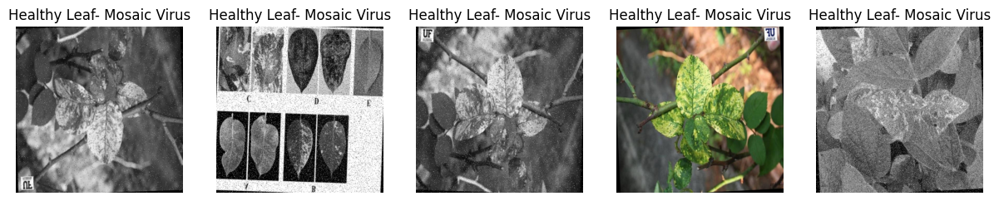

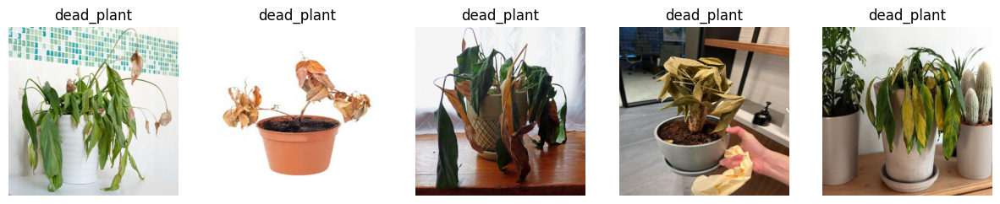

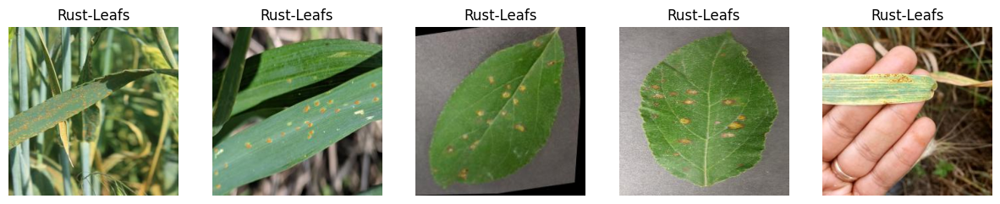

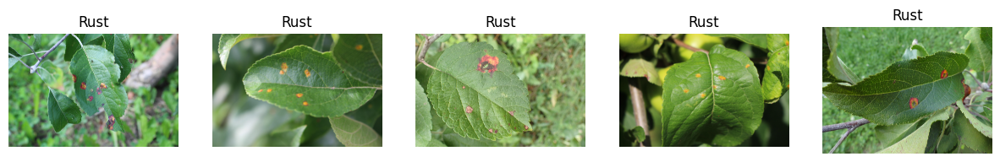

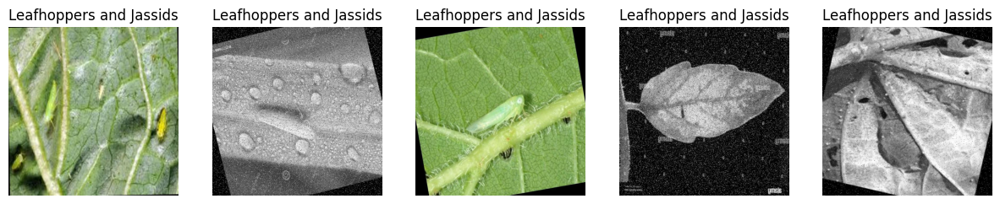

...

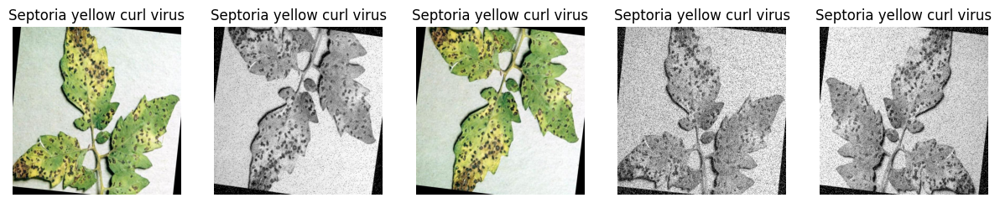

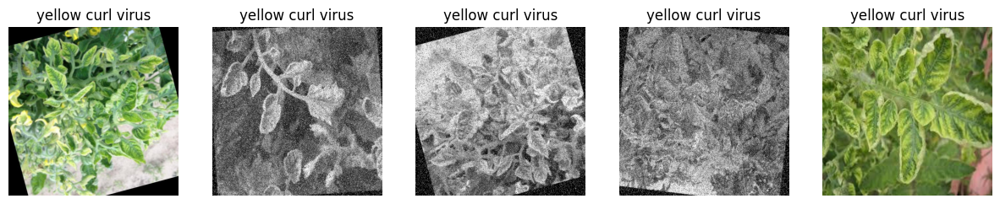

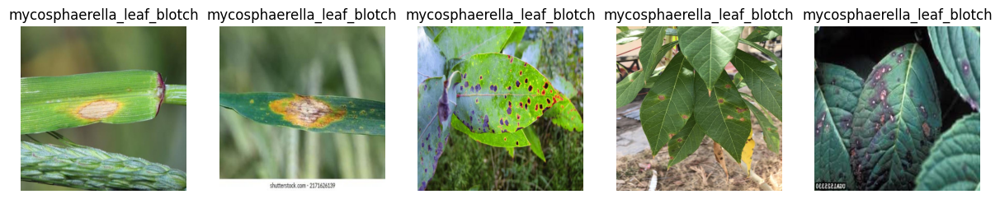

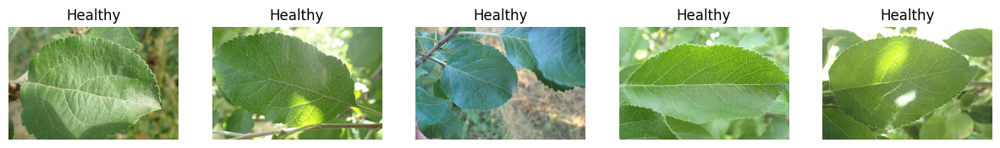

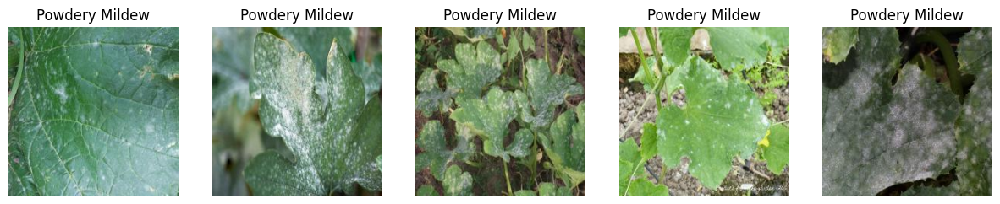

In [18]:
display_random_images(directory, num_images=5)

In [19]:
# Mendapatkan list label (nama folder di dalam augmented)
labels = [name for name in os.listdir(directory) if os.path.isdir(os.path.join(directory, name))]

print("Label yang ditemukan:")
labels

Label yang ditemukan:


['Healthy Leaf- Mosaic Virus',
 'dead_plant',
 'Rust-Leafs',
 'Rust',
 'Leafhoppers and Jassids',
 'bactarial canker',
 'Mold',
 'late_blight',
 'leaf_curl',
 'flea beetle',
 'leafminer powedry_mildew',
 'red_spot',
 'Fire-Blight',
 'yld',
 'Black rot',
 'bacterial spot',
 'Molds',
 'Leaf Curl',
 'bactarial canker late_blight',
 'Fusarium-Wilt',
 'Downey-Mildew',
 'rust',
 'Early Blight Healthy Leaf-',
 'Early Blight Healthy Leaf- late_blight',
 'Molds late_blight',
 'Mosaic Virus',
 'black_spot',
 'Early Blight',
 'Septoria late_blight',
 'Healthy Leaf- yellow curl virus',
 'Aphids',
 'botrytis_blight_disease',
 'Spot',
 'downy_mildew',
 'death_leaf',
 'Early Blight Healthy Leaf- late_blight yellow curl virus',
 'Scab',
 'Early-Blight',
 'healthy',
 'Blight',
 'insect_bite',
 'Healthy Leaf- bacterial spot',
 'scorch',
 'Late-Blight',
 'Powdery',
 'Healthy Leaf- late_blight',
 'Powdery-Mildew',
 'blight',
 'Septoria',
 'leafminer',
 'cercospora_spot',
 'bacterial spot late_blight',
 'L

# Data Preparation

## Merging Data

In [20]:
# Mapping label
label_map = {
    "Rust": ['rust', 'Rust', 'leaf_curl', 'bacterial spot', 'bactarial canker'],
    "Blight": ['blight', 'early_blight', 'Blight', 'botrytis_blight_disease', 'scorch', 'yld'],
    "Dead Leaf": ['death_leaf', 'dead_plant'],
    "Spot Diseases": ['cercospora_spot', 'black_spot', 'Spot', 'septoria_spot', 'red_spot', 'Scab'],
    "Healthy": ['healthy', 'Healthy'],
    "Early Blight": [
        'Early-Blight', 'Early Blight', 'Early Blight late_blight',
        'Early Blight Healthy Leaf-', 'Early Blight Healthy Leaf- late_blight',
        'Early Blight Healthy Leaf- late_blight yellow curl virus', 'Fusarium-Wilt'
    ],
    "Late Blight": [
        'late_blight', 'Late-Blight', 'bacterial spot late_blight',
        'Healthy Leaf- late_blight',
        'Molds Septoria late_blight yellow curl virus',
        'bactarial canker late_blight', 'Early Blight late_blight',
        'Early Blight Healthy Leaf- late_blight', 'Healthy Leaf- late_blight',
        'Molds Septoria late_blight yellow curl virus', 'bactarial canker late_blight'
    ],
    "Fungal": [
        'Molds', 'Molds late_blight', 'Rust-Leafs', 'Leaf-Spot', 'Fire-Blight',
        'Healthy Leaf- Molds', 'Mold', 'mycosphaerella_leaf_blotch', 'Black rot'
    ],
    "Mildew": [
        'powdery_mildew', 'Powdery', 'Powdery Mildew', 'downy_mildew', 'powedry_mildew', 'Powdery-Mildew', 'Downey-Mildew',
        'leafminer powedry_mildew', 'Leafminer powedry_mildew'
    ],
    "Septoria": [
        'Septoria', 'Septoria yellow curl virus', 'Septoria late_blight', 'Healthy Leaf- bacterial spot', 'Septoria late_blight', 
    ],
    "Virus": [
        'Mosaic Virus', 'yellow curl virus', 'Healthy Leaf- Mosaic Virus',
        'Healthy Leaf- yellow curl virus'
    ],
    "Insects": [
        'Aphids', 'flea beetle', 'leafminer', 'Leaf Curl',
        'Leafhoppers and Jassids', 'insect_bite'
    ]
}

In [21]:
# source_dir2 adalah direktori sumber dan juga target
reverse_map = {}
for new_label, old_labels in label_map.items():
    for old_label in old_labels:
        reverse_map[old_label] = new_label

# Siapkan folder sementara untuk hasil penggabungan
temp_dir = directory + '_temp'
os.makedirs(temp_dir, exist_ok=True)

# Gabungkan isi folder sesuai mapping, simpan di folder sementara
for folder_name in os.listdir(directory):
    src_folder = os.path.join(directory, folder_name)
    if os.path.isdir(src_folder):
        new_label = reverse_map.get(folder_name)
        if new_label:
            dst_folder = os.path.join(temp_dir, new_label)

            # Buat folder target baru dan salin isinya
            os.makedirs(dst_folder, exist_ok=True)
            shutil.copytree(src_folder, dst_folder, dirs_exist_ok=True)
            print(f"[✓] '{folder_name}' ➜ '{new_label}'")
        else:
            print(f"Label tidak dikenali: '{folder_name}' ➜ Lewat")

# Hapus semua folder lama
for folder_name in os.listdir(directory):
    folder_path = os.path.join(directory, folder_name)
    if os.path.isdir(folder_path):
        shutil.rmtree(folder_path)

# Pindahkan hasil dari temp ke source_dir2
for folder_name in os.listdir(temp_dir):
    src = os.path.join(temp_dir, folder_name)
    dst = os.path.join(directory, folder_name)
    shutil.move(src, dst)

# Hapus folder temp
os.rmdir(temp_dir)
print("\nSemua data telah digabung dan diganti di folder sumber.")

[✓] 'Healthy Leaf- Mosaic Virus' ➜ 'Virus'
[✓] 'dead_plant' ➜ 'Dead Leaf'
[✓] 'Rust-Leafs' ➜ 'Fungal'
[✓] 'Rust' ➜ 'Rust'
[✓] 'Leafhoppers and Jassids' ➜ 'Insects'
[✓] 'bactarial canker' ➜ 'Rust'
[✓] 'Mold' ➜ 'Fungal'
[✓] 'late_blight' ➜ 'Late Blight'
[✓] 'leaf_curl' ➜ 'Rust'
[✓] 'flea beetle' ➜ 'Insects'
[✓] 'leafminer powedry_mildew' ➜ 'Mildew'
[✓] 'red_spot' ➜ 'Spot Diseases'
[✓] 'Fire-Blight' ➜ 'Fungal'
[✓] 'yld' ➜ 'Blight'
[✓] 'Black rot' ➜ 'Fungal'
[✓] 'bacterial spot' ➜ 'Rust'
[✓] 'Molds' ➜ 'Fungal'
[✓] 'Leaf Curl' ➜ 'Insects'
[✓] 'bactarial canker late_blight' ➜ 'Late Blight'
[✓] 'Fusarium-Wilt' ➜ 'Early Blight'
[✓] 'Downey-Mildew' ➜ 'Mildew'
[✓] 'rust' ➜ 'Rust'
[✓] 'Early Blight Healthy Leaf-' ➜ 'Early Blight'
[✓] 'Early Blight Healthy Leaf- late_blight' ➜ 'Late Blight'
[✓] 'Molds late_blight' ➜ 'Fungal'
[✓] 'Mosaic Virus' ➜ 'Virus'
[✓] 'black_spot' ➜ 'Spot Diseases'
[✓] 'Early Blight' ➜ 'Early Blight'
[✓] 'Septoria late_blight' ➜ 'Septoria'
[✓] 'Healthy Leaf- yellow curl viru

In [22]:
# Mendapatkan list label setelah dilakukan mapping
labels = [name for name in os.listdir(directory) if os.path.isdir(os.path.join(directory, name))]

print("Label yang ditemukan:")
labels

Label yang ditemukan:


['Mildew',
 'Rust',
 'Insects',
 'Spot Diseases',
 'Early Blight',
 'Blight',
 'Late Blight',
 'Septoria',
 'Virus',
 'Dead Leaf',
 'Fungal',
 'Healthy']

## Augmentasi

In [26]:
# Membuat fungsi untuk melakukan rotasi berlawanan arah jarum jam
def anticlockwise_rotation(img):
    img = tf.image.resize(img, (224, 224))
    img = tf.image.rot90(img, k=random.randint(1, 4))  # Rotasi 90, 180, atau 270 derajat secara acak
    return img

# Membuat fungsi untuk melakukan rotasi searah jarum jam
def clockwise_rotation(img):
    img = tf.image.resize(img, (224, 224))
    img = tf.image.rot90(img, k=random.randint(1, 4))  # Rotasi 90, 180, atau 270 derajat secara acak
    return img

# Membuat fungsi untuk membalik gambar secara vertikal dari atas ke bawah
def flip_up_down(img):
    img = tf.image.resize(img, (224, 224))
    img = tf.image.flip_up_down(img)
    return img

# Membuat fungsi untuk memberikan efek peningkatan kecerahan pada gambar
def add_brightness(img):
    img = tf.image.resize(img, (224, 224))
    img = tf.image.adjust_brightness(img, delta=random.uniform(0.1, 0.5))  # Sesuaikan nilai delta sesuai kebutuhan
    return img

# Buat layer augmentasi blur
blur_layer = keras_cv.layers.RandomGaussianBlur(kernel_size=3, factor=(0.1, 2.0))
def blur_image(img):
    img = tf.image.resize(img, (224, 224))
    img = blur_layer(img)
    return img

# Membuat fungsi untuk memberikan efek pergeseran acak pada gambar
def sheared(img):
    img = tf.image.resize(img, (224, 224))
    # Buat objek ImageDataGenerator dengan parameter shearing range
    datagen = ImageDataGenerator(shear_range=0.2)
    img = next(iter(datagen.flow(tf.expand_dims(img, 0))))[0]
    return img

# Membuat fungsi untuk melakukan pergeseran melengkung pada gambar
def warp_shift(img):
    img = tf.image.resize(img, (224, 224))
    # Buat objek ImageDataGenerator dengan parameter width_shift_range dan height_shift_range
    datagen = ImageDataGenerator(width_shift_range=0.1, height_shift_range=0.1)
    img = next(iter(datagen.flow(tf.expand_dims(img, 0))))[0]
    return img

I0000 00:00:1749738456.212836      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1749738456.213504      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


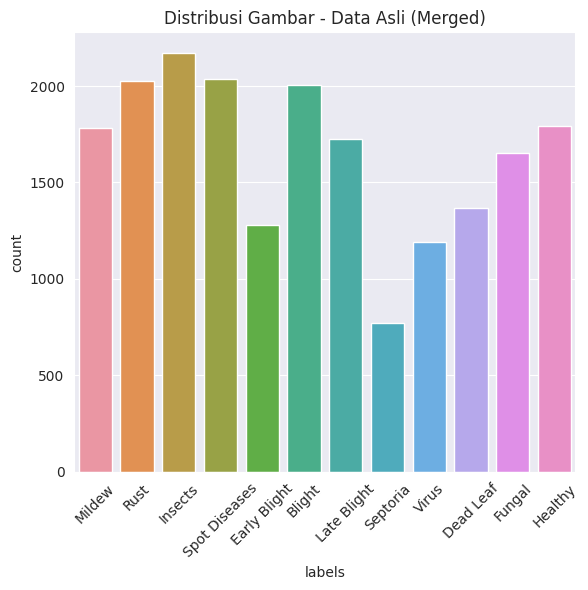

In [23]:
def get_label_distribution(directory, title):
    file_name, labels, full_path = [], [], []

    for path, _, files in os.walk(directory):
        for name in files:
            full_path.append(os.path.join(path, name))
            labels.append(os.path.basename(path))  # lebih aman dari path.split('/')
            file_name.append(name)

    df = pd.DataFrame({"path": full_path, 'file_name': file_name, "labels": labels})

    # Plot distribusi label
    plt.figure(figsize=(6,6))
    sns.set_style("darkgrid")
    sns.countplot(x='labels', data=df)
    plt.title(f'Distribusi Gambar - {title}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Panggil fungsi untuk kedua folder
get_label_distribution(directory, 'Data Asli (Merged)')

In [27]:
augmentations = [anticlockwise_rotation, clockwise_rotation, flip_up_down, add_brightness, blur_layer, sheared, warp_shift]

# Variabel utama
base_path = "leaf_disease/dataset"

# Proses augmentasi
for label in labels:
    label_path = os.path.join(base_path, label)
    existing_images = [f for f in os.listdir(label_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    n_current = len(existing_images)

    if n_current >= 3000:
        continue

    print(f"Augmenting {label}: {n_current} images available")

    count = 0
    while n_current + count < 3000:
        img_name = random.choice(existing_images)
        img_path = os.path.join(label_path, img_name)

        img = load_img(img_path)
        img_array = img_to_array(img)

        aug_func = random.choice(augmentations)
        aug_img = aug_func(img_array)

        aug_pil_img = array_to_img(aug_img)
        new_filename = f"aug_{count}_{img_name}"
        aug_pil_img.save(os.path.join(label_path, new_filename))

        count += 1

    print(f"Finished augmenting {label}, total images: {n_current + count}")

Augmenting Mildew: 1781 images available
Finished augmenting Mildew, total images: 3000
Augmenting Rust: 2028 images available
Finished augmenting Rust, total images: 3000
Augmenting Insects: 2170 images available
Finished augmenting Insects, total images: 3000
Augmenting Spot Diseases: 2038 images available
Finished augmenting Spot Diseases, total images: 3000
Augmenting Early Blight: 1277 images available
Finished augmenting Early Blight, total images: 3000
Augmenting Blight: 2007 images available
Finished augmenting Blight, total images: 3000
Augmenting Late Blight: 1725 images available
Finished augmenting Late Blight, total images: 3000
Augmenting Septoria: 771 images available
Finished augmenting Septoria, total images: 3000
Augmenting Virus: 1193 images available
Finished augmenting Virus, total images: 3000
Augmenting Dead Leaf: 1366 images available
Finished augmenting Dead Leaf, total images: 3000
Augmenting Fungal: 1654 images available
Finished augmenting Fungal, total imag

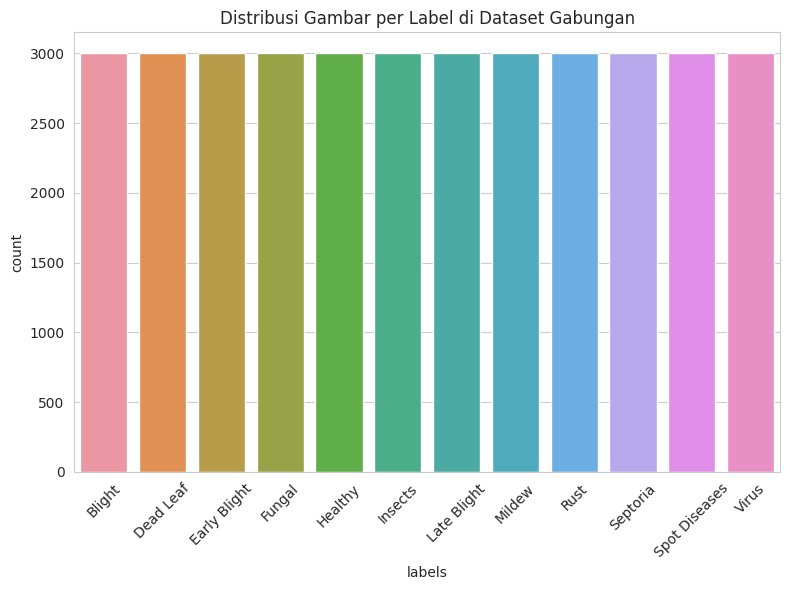

In [28]:
dataset_dir = 'leaf_disease/dataset'

# Fungsi untuk membaca semua gambar dan label dalam dataset
def load_dataset_distribution(dataset_dir):
    file_paths = []
    labels = []

    for label_name in os.listdir(dataset_dir):
        label_path = os.path.join(dataset_dir, label_name)
        if os.path.isdir(label_path):
            for file in os.listdir(label_path):
                file_paths.append(os.path.join(label_path, file))
                labels.append(label_name)

    return pd.DataFrame({"path": file_paths, "labels": labels})

df_dataset = load_dataset_distribution(dataset_dir)
# Plot distribusi label
plt.figure(figsize=(8, 6))
sns.set_style("whitegrid")
sns.countplot(x='labels', data=df_dataset, order=sorted(df_dataset['labels'].unique()))
plt.title("Distribusi Gambar per Label di Dataset Gabungan")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Train Test Split Data

In [29]:
# Panggil variabel mypath yang menampung folder dataset gambar
mypath= 'leaf_disease/dataset/'

file_name = []
labels = []
full_path = []
for path, subdirs, files in os.walk(mypath):
    for name in files:
        full_path.append(os.path.join(path, name))
        labels.append(path.split('/')[-1])
        file_name.append(name)


# Memasukan variabel yang sudah dikumpulkan pada looping di atas menjadi sebuah dataframe agar rapih
df = pd.DataFrame({"path":full_path,'file_name':file_name,"labels":labels})
# Melihat jumlah data gambar pada masing-masing label
df.groupby(['labels']).size()

labels
Blight           3000
Dead Leaf        3000
Early Blight     3000
Fungal           3000
Healthy          3000
Insects          3000
Late Blight      3000
Mildew           3000
Rust             3000
Septoria         3000
Spot Diseases    3000
Virus            3000
dtype: int64

In [30]:
# Variabel yang digunakan pada pemisahan data ini dimana variabel x = data path dan y = data labels
X= df['path']
y= df['labels']

# Split dataset awal menjadi data train dan test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=300)

In [31]:
# Menyatukan kedalam masing-masing dataframe
df_tr = pd.DataFrame({'path':X_train,'labels':y_train,'set':'train'})
df_te = pd.DataFrame({'path':X_test,'labels':y_test,'set':'test'})

In [32]:
# Print hasil diatas untuk melihat panjang size data training dan testing
print('train size', len(df_tr))
print('test size', len(df_te))

train size 28800
test size 7200


In [33]:
# Gabungkan DataFrame df_tr dan df_te
df_all = pd.concat([df_tr, df_te], ignore_index=True)

print('===================================================== \n')
print(df_all.groupby(['set', 'labels']).size(), '\n')
print('===================================================== \n')

# Cek sample data
print(df_all.sample(5))


set    labels       
test   Blight            602
       Dead Leaf         605
       Early Blight      588
       Fungal            596
       Healthy           629
       Insects           611
       Late Blight       561
       Mildew            555
       Rust              589
       Septoria          638
       Spot Diseases     589
       Virus             637
train  Blight           2398
       Dead Leaf        2395
       Early Blight     2412
       Fungal           2404
       Healthy          2371
       Insects          2389
       Late Blight      2439
       Mildew           2445
       Rust             2411
       Septoria         2362
       Spot Diseases    2411
       Virus            2363
dtype: int64 


                                                    path     labels    set
35032             leaf_disease/dummy/Insects/test104.jpg    Insects   test
16013       leaf_disease/dummy/Rust/c3542f42de8f1693.jpg       Rust  train
17646                leaf_disease/dummy/D

In [34]:
# Memanggil dataset asli yang berisi keseluruhan data gambar yang sesuai dengan labelnya
datasource_path = "leaf_disease/dataset"
# Membuat variabel Dataset, dimana nanti menampung data yang telah dilakukan pembagian data training dan testing
dataset_path = "Dataset-Final/"

In [36]:
# Buat dataframe gambar
image_paths = []
labels = []

for label in os.listdir(datasource_path):
    label_path = os.path.join(datasource_path, label)
    for img in os.listdir(label_path):
        image_paths.append(os.path.join(label_path, img))
        labels.append(label)

df_all = pd.DataFrame({'path': image_paths})
df_all['labels'] = labels
df_all['image'] = df_all['path'].apply(lambda x: os.path.basename(x))

# Split train/test
df_all['set'] = 'train'
df_all.loc[df_all.sample(frac=0.2, random_state=42).index, 'set'] = 'test'

# Salin gambar ke direktori sesuai struktur train/test
for index, row in tq(df_all.iterrows(), total=df_all.shape[0]):
    file_path = row['path']
    dest_dir = os.path.join(dataset_path, row['set'], row['labels'])

    os.makedirs(dest_dir, exist_ok=True)

    destination_file_name = os.path.basename(file_path)
    file_dest = os.path.join(dest_dir, destination_file_name)

    if not os.path.exists(file_dest):
        shutil.copy2(file_path, file_dest)

  0%|          | 0/36000 [00:00<?, ?it/s]

## Image Data Generator

In [37]:
# Definisi direktori
TRAIN_DIR = "Dataset-Final/train/"
TEST_DIR = "Dataset-Final/test/"
categories = sorted(os.listdir(TRAIN_DIR))  # otomatis ambil label dari folder train

# Cek jumlah data per kategori
for category in categories:
    print(f"{category} - train: {len(os.listdir(os.path.join(TRAIN_DIR, category)))} | test: {len(os.listdir(os.path.join(TEST_DIR, category)))}")

# Image generators
train_datagen = ImageDataGenerator(rescale=1./255, validation_split=0.2)
test_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    'Dataset-Final/train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='training',
    shuffle=True,
    seed=42
)

validation_generator = train_datagen.flow_from_directory(
    'Dataset-Final/train',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    subset='validation',
    shuffle=True,
    seed=42
)

# Untuk evaluasi nanti
test_datagen = ImageDataGenerator(rescale=1./255)
test_generator = test_datagen.flow_from_directory(
    'Dataset-Final/test',
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Blight - train: 2418 | test: 582
Dead Leaf - train: 2405 | test: 595
Early Blight - train: 2383 | test: 617
Fungal - train: 2376 | test: 624
Healthy - train: 2383 | test: 617
Insects - train: 2380 | test: 620
Late Blight - train: 2406 | test: 594
Mildew - train: 2404 | test: 596
Rust - train: 2376 | test: 624
Septoria - train: 2417 | test: 583
Spot Diseases - train: 2440 | test: 560
Virus - train: 2412 | test: 588
Found 23044 images belonging to 12 classes.
Found 5756 images belonging to 12 classes.
Found 7200 images belonging to 12 classes.


## Class Weights

In [38]:
label_map = train_generator.class_indices
inv_label_map = {v: k for k, v in label_map.items()}

count_classes = {
    i: len(os.listdir(os.path.join("Dataset-Final/train", inv_label_map[i])))
    for i in inv_label_map
}

total_images = sum(count_classes.values())
class_weights = {
    i: (1 / count) * (total_images / len(count_classes))
    for i, count in count_classes.items()
}
print("Class Weights:", class_weights)

Class Weights: {0: 0.9925558312655087, 1: 0.997920997920998, 2: 1.0071338648762065, 3: 1.0101010101010102, 4: 1.0071338648762065, 5: 1.0084033613445378, 6: 0.9975062344139651, 7: 0.9983361064891847, 8: 1.0101010101010102, 9: 0.9929664873810509, 10: 0.9836065573770492, 11: 0.9950248756218906}


# Modeling and Result

In [40]:
# Inisialisasi MobileNetV2 tanpa top layer (fully-connected) dan dengan bobot pre-trained dari ImageNet
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze semua layer pada base model (feature extraction)
for layer in base_model.layers:
    layer.trainable = False

# Tambahkan custom classification head
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(train_generator.num_classes, activation='softmax')(x)

# Bangun model akhir
model = Model(inputs=base_model.input, outputs=predictions)

# Kompilasi model
model.compile(optimizer=Adam(learning_rate=0.0001),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Callback
checkpoint = ModelCheckpoint("mobilenetv2_bestmodel_kesekiankali.h5", monitor='val_accuracy', save_best_only=True, verbose=1)
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6, verbose=1)

# Training awal (feature extraction)
history = model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=100,  # Kurangi epoch untuk trial
    callbacks=[checkpoint, early_stop, reduce_lr]
)

# ----------- Fine-Tuning -----------
# Unfreeze sebagian layer akhir dari base model untuk fine-tuning
for layer in base_model.layers[-60:]:
    layer.trainable = True

# Kompilasi ulang model dengan learning rate lebih kecil
model.compile(optimizer=Adam(learning_rate=1e-5),
              loss='categorical_crossentropy',
              metrics=['accuracy'])

# Fine-tuning training
history_finetune = model.fit(
    train_generator,
    validation_data=validation_generator,
    epochs=15,  # Cukup beberapa epoch saja untuk fine-tuning
    callbacks=[checkpoint, early_stop,  reduce_lr]
)

# Simpan model final (replace .h5 file)
model.save("mobilenetv2_semogabagus.h5")

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.


Epoch 1/100


I0000 00:00:1749738993.373546     116 service.cc:148] XLA service 0x7ef5b4004d60 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1749738993.379094     116 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1749738993.379116     116 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1749738994.565797     116 cuda_dnn.cc:529] Loaded cuDNN version 90300


  1/721 ━━━━━━━━━━━━━━━━━━━━ 3:06:03 16s/step - accuracy: 0.0312 - loss: 3.8685

I0000 00:00:1749739001.153217     116 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


721/721 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step - accuracy: 0.1632 - loss: 2.7848
Epoch 1: val_accuracy improved from -inf to 0.45188, saving model to mobilenetv2_bestmodel_kesekiankali.h5
721/721 ━━━━━━━━━━━━━━━━━━━━ 148s 183ms/step - accuracy: 0.1633 - loss: 2.7843 - val_accuracy: 0.4519 - val_loss: 1.7704 - learning_rate: 1.0000e-04
Epoch 2/100
721/721 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - accuracy: 0.3406 - loss: 1.9245
Epoch 2: val_accuracy improved from 0.45188 to 0.52085, saving model to mobilenetv2_bestmodel_kesekiankali.h5
721/721 ━━━━━━━━━━━━━━━━━━━━ 117s 162ms/step - accuracy: 0.3406 - loss: 1.9244 - val_accuracy: 0.5208 - val_loss: 1.4810 - learning_rate: 1.0000e-04
Epoch 3/100
721/721 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step - accuracy: 0.4080 - loss: 1.6888
Epoch 3: val_accuracy improved from 0.52085 to 0.54830, saving model to mobilenetv2_bestmodel_kesekiankali.h5
721/721 ━━━━━━━━━━━━━━━━━━━━ 117s 162ms/step - accuracy: 0.4080 - loss: 1.6888 - val_accuracy: 0.5483 - val_loss: 1.3599

# Evaluasi Model

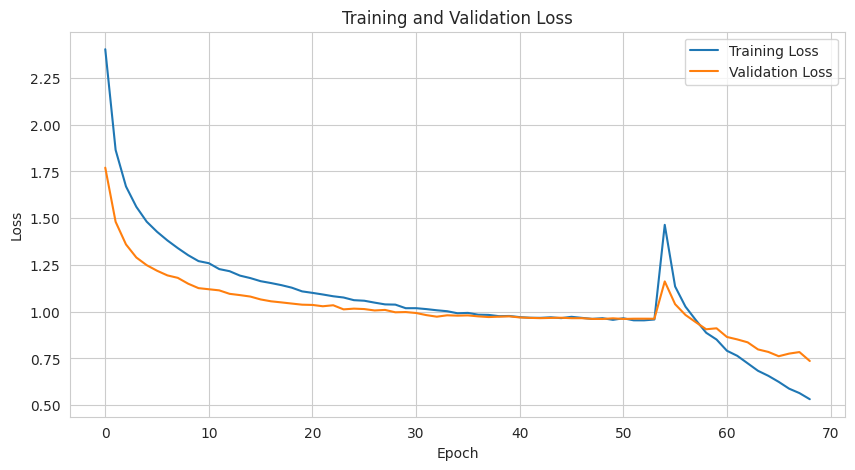

In [41]:
# Gabungkan hasil history awal dan fine-tuning
val_loss = history.history['val_loss'] + history_finetune.history['val_loss']
loss = history.history['loss'] + history_finetune.history['loss']
val_acc = history.history['val_accuracy'] + history_finetune.history['val_accuracy']
acc = history.history['accuracy'] + history_finetune.history['accuracy']

# Plot grafik loss
plt.figure(figsize=(10, 5))
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

225/225 ━━━━━━━━━━━━━━━━━━━━ 31s 122ms/step


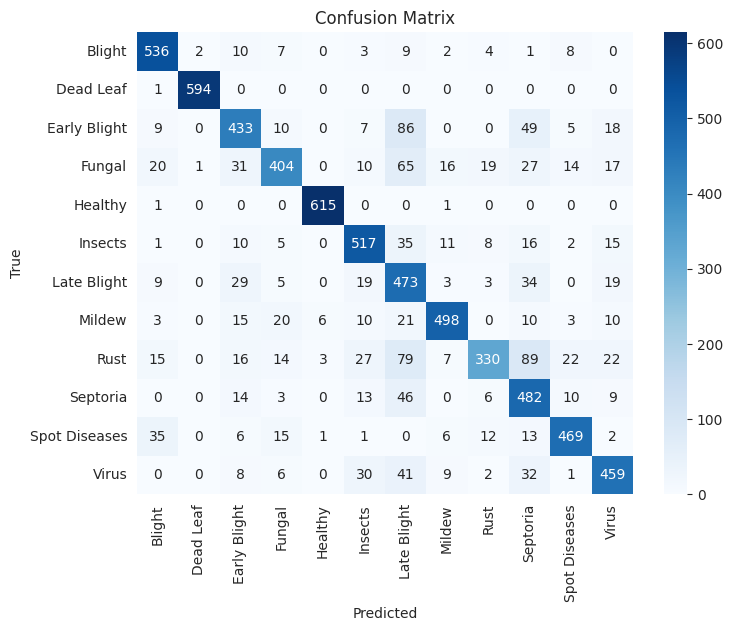

               precision    recall  f1-score   support

       Blight       0.85      0.92      0.88       582
    Dead Leaf       0.99      1.00      1.00       595
 Early Blight       0.76      0.70      0.73       617
       Fungal       0.83      0.65      0.73       624
      Healthy       0.98      1.00      0.99       617
      Insects       0.81      0.83      0.82       620
  Late Blight       0.55      0.80      0.65       594
       Mildew       0.90      0.84      0.87       596
         Rust       0.86      0.53      0.65       624
     Septoria       0.64      0.83      0.72       583
Spot Diseases       0.88      0.84      0.86       560
        Virus       0.80      0.78      0.79       588

     accuracy                           0.81      7200
    macro avg       0.82      0.81      0.81      7200
 weighted avg       0.82      0.81      0.81      7200



In [42]:
# Prediksi label
test_generator.reset()
preds = model.predict(test_generator)
y_pred = np.argmax(preds, axis=1)
y_true = test_generator.classes

# Confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_labels = list(test_generator.class_indices.keys())

plt.figure(figsize=(8,6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# Optional: classification report
print(classification_report(y_true, y_pred, target_names=class_labels))

# Inferensi Model

In [43]:
# Ambil nama kelas dari train_generator
class_names = list(train_generator.class_indices.keys())

# Buat dan simpan LabelEncoder
label_encoder = LabelEncoder()
label_encoder.fit(class_names)

# Simpan ke file .pkl
with open("label_encoder.pkl", "wb") as f:
    pickle.dump(label_encoder, f)

print("Label encoder berhasil disimpan ke 'label_encoder.pkl'")

Label encoder berhasil disimpan ke 'label_encoder.pkl'


In [47]:
def predict_plant_disease(image_path, model_path, label_encoder_path):
    # Load trained model
    model = load_model(model_path)

    # Load label encoder
    with open(label_encoder_path, 'rb') as f:
        label_encoder = pickle.load(f)

    # Load and preprocess image
    img = image.load_img(image_path, target_size=(224, 224))  # Sesuaikan dengan input model
    img_array = image.img_to_array(img) / 255.0
    img_array = np.expand_dims(img_array, axis=0)

    # Predict class probabilities
    prediction = model.predict(img_array)
    predicted_index = np.argmax(prediction)
    predicted_label = label_encoder.inverse_transform([predicted_index])[0]
    confidence = prediction[0][predicted_index]

    # Display image with prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"{predicted_label} ({confidence:.2%})")
    plt.show()

    # Print prediction summary
    print(f"✅ Prediksi penyakit tanaman: {predicted_label}")
    print(f"🔍 Confidence: {confidence:.2%}")
    print("\n📊 Detail Probabilitas Tiap Kelas:")
    for i, prob in enumerate(prediction[0]):
        label = label_encoder.inverse_transform([i])[0]
        print(f"• {label:15}: {prob:.4f}")

    return predicted_label, confidence

In [60]:
# Ambil gambar dari URL
url = "https://asset.kompas.com/crops/uLU5Z6pvdzIGQQenO02l5B1vego=/102x66:898x598/750x500/data/photo/2021/08/02/610777725ae43.jpg"
response = requests.get(url)
img = Image.open(BytesIO(response.content))

# Simpan gambar ke file lokal
image_save_path = "/kaggle/working/downloaded_image.jpg"
img.save(image_save_path)

1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step


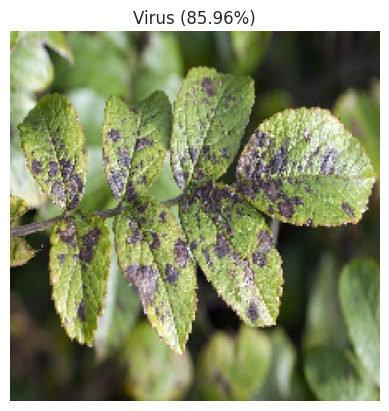

✅ Prediksi penyakit tanaman: Virus
🔍 Confidence: 85.96%

📊 Detail Probabilitas Tiap Kelas:
• Blight         : 0.0015
• Dead Leaf      : 0.0000
• Early Blight   : 0.0006
• Fungal         : 0.0324
• Healthy        : 0.0002
• Insects        : 0.0006
• Late Blight    : 0.0006
• Mildew         : 0.0647
• Rust           : 0.0123
• Septoria       : 0.0007
• Spot Diseases  : 0.0268
• Virus          : 0.8596


('Virus', 0.85963035)

In [61]:
# Panggil fungsi prediksi
predict_plant_disease(
    image_path=image_save_path,
    model_path="/kaggle/working/mobilenetv2_bestmodel_kesekiankali.h5",
    label_encoder_path="/kaggle/working/label_encoder.pkl"
)